In [1]:
# Librerias
from skimage import io
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

# DATASET

## 1. Descripción
El Daset se creo usando:
* Un archivo [KML](https://drive.google.com/open?id=14ZBlH8OsG00LDFhQVrZSE1ajkX9-IzQU) de los estratos de bogota 
* El programa libre [SASplanet](https://bitbucket.org/sas_team/sas.planet.bin/downloads/) para descargar las imagenes. 

Un pequeño tutotial de [SASplanet](https://www.youtube.com/watch?v=g05X5M8ucTI)


<table style="border:0px">
<tbody>
<tr>
<td style="border:0px">
<img style="width:50%" src="./data/dataset/train/satellite/13/zoom_13.jpg"/>
</td>
<td style="border:0px">
<img  style="width:50%" style="border:none" src="./data/dataset/train/layer_economic/13/zoom_layer_13.jpg"/>
</td>
</tr>
<tr>
<td>
<center>
Satelital
</td>
<td>
    <center>
Estrato
</td>
</tr>
</tbody>
</table>


Se sacaron dos tipos de imagenes, en distintos niveles de zoom, imagenes satelitales y su contraparte en KML. las distintas iamgenes con los distintos niveles de zoom se pueden encontrar en el directorio `./data/dataset`.

In [2]:
PATH_DATASET = "./data/dataset"
PATH_DATASET_TRAIN = "./data/dataset/train"
PATH_DATASET_TEST = "./data/dataset/test"

## 2. TRAIN & TEST

El conjunto de imagenes de todo bogota se dividio en dos partes `./data/dataset/train` y `./data/dataset/test`, ambas con una cantidad considerable de los distintos niveles socioeconomicos para no hacer un mal entrenamiento, la division se llevo acabo de forma geografica como lo muestra la siguiente imagen.

<center>
<div style="width:40%">
                       
![test_train](./vector/train_test_map.svg)
</div>

</center>
## 2. Exploración
Acontinuacion una pequeña exploracion del dataset


### 2.1 Contenido


In [2]:
!ls -R {PATH_DATASET_TRAIN}/layer_economic

./data/dataset/train/layer_economic:
13  14	15  16	17  18	19  20	21

./data/dataset/train/layer_economic/13:
zoom_layer_13.jpg

./data/dataset/train/layer_economic/14:
zoom_layer_14.jpg

./data/dataset/train/layer_economic/15:
zoom_layer_15.jpg

./data/dataset/train/layer_economic/16:
zoom_layer_16_1-1.jpg  zoom_layer_16_2-1.jpg
zoom_layer_16_1-2.jpg  zoom_layer_16_2-2.jpg

./data/dataset/train/layer_economic/17:
zoom_layer_17_1-2.jpg  zoom_layer_17_2-2.jpg  zoom_layer_17_3-2.jpg
zoom_layer_17_1-3.jpg  zoom_layer_17_2-3.jpg
zoom_layer_17_2-1.jpg  zoom_layer_17_3-1.jpg

./data/dataset/train/layer_economic/18:
zoom_layer_18_1-3.jpg  zoom_layer_18_3-2.jpg  zoom_layer_18_4-3.jpg
zoom_layer_18_1-4.jpg  zoom_layer_18_3-3.jpg  zoom_layer_18_4-4.jpg
zoom_layer_18_1-5.jpg  zoom_layer_18_3-4.jpg  zoom_layer_18_5-1.jpg
zoom_layer_18_2-3.jpg  zoom_layer_18_3-5.jpg  zoom_layer_18_5-2.jpg
zoom_layer_18_2-4.jpg  zoom_layer_18_4-1.jpg
zoom_layer_18_2-5.jpg  zoom_layer_18_4-2.jpg

./data/dataset/train/

In [3]:
!ls -R {PATH_DATASET_TEST}/satellite

./data/dataset/test/satellite:
13  14	15  16	17  18	19  20	21

./data/dataset/test/satellite/13:
zoom_13.jpg

./data/dataset/test/satellite/14:
zoom_14.jpg

./data/dataset/test/satellite/15:
zoom_15.jpg

./data/dataset/test/satellite/16:
zoom_16_1-1.jpg  zoom_16_1-2.jpg  zoom_16_2-1.jpg  zoom_16_2-2.jpg

./data/dataset/test/satellite/17:
zoom_17_1-2.jpg  zoom_17_2-1.jpg  zoom_17_2-3.jpg  zoom_17_3-2.jpg
zoom_17_1-3.jpg  zoom_17_2-2.jpg  zoom_17_3-1.jpg

./data/dataset/test/satellite/18:
zoom_18_1-4.jpg  zoom_18_2-5.jpg  zoom_18_4-1.jpg  zoom_18_5-2.jpg
zoom_18_1-5.jpg  zoom_18_3-2.jpg  zoom_18_4-2.jpg
zoom_18_2-3.jpg  zoom_18_3-3.jpg  zoom_18_4-3.jpg
zoom_18_2-4.jpg  zoom_18_3-4.jpg  zoom_18_5-1.jpg

./data/dataset/test/satellite/19:
zoom_19_10-1.jpg  zoom_19_3-9.jpg   zoom_19_5-8.jpg  zoom_19_8-2.jpg
zoom_19_1-8.jpg   zoom_19_4-10.jpg  zoom_19_5-9.jpg  zoom_19_8-3.jpg
zoom_19_1-9.jpg   zoom_19_4-5.jpg   zoom_19_6-3.jpg  zoom_19_8-4.jpg
zoom_19_2-10.jpg  zoom_19_4-6.jpg   zoom_19_6-4.j

### 2.1 Eliminando imagenes grises
Al ver el dataset [dataset raw - Bogota Estrato Economico](https://drive.google.com/open?id=1cQPLqVHW9f7alj_CNRApJNj-XmqDDXb3) existen "imagenes grises" que dañarian el entrenamiento de la Red neuronal a usar para la prediccion, por ende se eliminan dichas imagnes

In [108]:
# IMAGENES GRISES TEST
zoom = [17, 18, 19, 20, 21]
imgs = [["1-1", "3-3"], ["1-1", "1-2", "1-3", "2-1", "2-2", "3-1", "3-5", "4-4", "4-5", "5-3", "5-4", "5-5"], ["1-1", "1-2","1-3","1-4","1-5","1-6","1-7","1-10","2-1","2-2","2-3","2-4","2-5","2-6",         "3-1","3-2","3-3","3-4","4-1","4-2","4-3","4-4","5-10","6-1","6-2","5-1","5-2","6-8",         "6-9","6-10","7-1","7-2","7-7","7-8","7-9","7-10","8-7","8-8","8-9","8-10","9-5","9-6",         "9-7","9-8","9-9", "9-10", "10-2", "10-3", "10-4", "10-5", "10-6", "10-7", "10-8", "10-9", "10-10"],        ["1-1","1-2","1-3","1-4","1-5","1-6","1-7","1-8","1-9","1-10","1-11","1-15","1-16",         "2-1","2-2","2-3","2-4","2-5","2-6","2-7","2-8","2-9","2-10","2-11","2-15","2-16",         "3-1","3-2","3-3","3-4","3-5","3-6","3-7","3-8","3-9","3-10","3-11", "3-16", "4-1",         "4-2","4-3","4-4","4-5","4-6","4-7", "4-10", "5-1", "5-2", "5-3", "5-4", "5-5", "5-6",         "5-7", "6-1", "6-2", "6-3", "6-4", "6-5", "6-6", "6-15", "7-1", "7-2", "7-3", "7-4",         "7-5", "7-15", "7-16", "8-1", "8-2", "8-3", "8-4", "8-14", "8-15", "8-16", "9-1",          "9-2", "9-3", "9-4", "9-12", "9-13", "9-14", "9-15", "9-16", "10-1", "10-2", "10-3",         "10-4", "10-12", "10-13", "10-14", "10-15", "10-16", "11-1", "11-2", "11-3", "11-4",         "11-11", "11-12", "11-13", "11-14", "11-15", "11-16", "12-1", "12-2", "12-3", "12-10",         "12-11", "12-12", "12-13", "12-14", "12-15", "12-16", "13-2", "13-3", "13-9", "13-10",         "13-11", "13-12", "13-13", "13-14", "13-15", "13-16", "14-3", "14-7", "14-8", "14-9",          "14-10", "14-11", "14-12", "14-13", "14-14", "14-15", "14-16", "15-5", "15-6", "15-7",         "15-8", "15-9", "15-10", "15-11", "15-12", "15-13", "15-14", "15-15", "15-16", "15-3",         "16-3", "16-4", "16-5", "16-6", "16-7", "16-8", "16-9", "16-10", "16-11", "16-12", "16-13",         "16-14", "16-15", "16-16"],        ["1-1","1-2","1-3","1-4","1-5","1-6","1-7","1-8","1-9","1-10", "1-11", "1-12", "1-13",         "1-14", "1-15", "1-16", "1-17", "1-18", "1-22", "1-23", "1-24", "1-25", "2-1", "2-2",         "2-3", "2-4", "2-5", "2-6", "2-7", "2-8", "2-9", "2-10", "2-11", "2-12", "2-13", "2-14",         "2-15", "2-16", "2-17", "2-22", "2-23", "2-24", "2-25", "3-1", "3-2", "3-3", "3-4", "3-5",          "3-6", "3-7", "3-8", "3-9", "3-10", "3-11", "3-12", "3-13", "3-14", "3-15", "3-16", "3-17",          "3-23", "3-24", "3-25", "4-1", "4-2", "4-3", "4-4", "4-5", "4-6", "4-7", "4-8", "4-9", "4-10",         "4-11", "4-12", "4-13", "4-14", "4-15", "4-16", "4-17", "4-23", "4-24", "4-25", "5-1", "5-2",         "5-3", "5-4", "5-5", "5-6", "5-7", "5-8", "5-9", "5-10", "5-11", "5-12", "5-13", "5-14",         "5-15", "5-16", "5-25", "6-1", "6-2", "6-3", "6-4", "6-5", "6-6", "6-7", "6-8", "6-9", "6-10",         "6-11", "6-12", "6-15", "6-16", "7-1", "7-2", "7-3", "7-4", "7-5", "7-6", "7-7", "7-8", "7-9",         "7-10", "7-11", "7-12", "7-16", "8-1", "8-2", "8-3", "8-4", "8-5", "8-6", "8-7", "8-8", "8-9",         "8-10", "8-11", "8-12", "9-1", "9-2", "9-3", "9-4", "9-5", "9-6", "9-7", "9-8", "9-9", "9-10",          "9-11", "9-12", "9-23", "9-24", "10-1", "10-2", "10-3", "10-4", "10-5", "10-6", "10-7", "10-8",         "10-9", "10-10", "10-23", "10-24", "10-25", "11-1", "11-2", "11-3", "11-4", "11-5", "11-6",         "11-7", "11-22", "11-23", "11-24", "11-25", "12-1", "12-2", "12-3", "12-4", "12-5", "12-6",         "12-21", "12-22", "12-23", "12-24", "12-25", "13-1", "13-2", "13-3", "13-4", "13-5", "13-6",          "13-19", "13-20", "13-21", "13-22", "13-23", "13-24", "13-25", "14-1", "14-2", "14-3", "14-4",         "14-5", "14-6", "14-18", "14-19", "14-20", "14-21", "14-22", "14-23", "14-24", "14-25", "15-1",         "15-2", "15-3", "15-4", "15-5", "15-6", "15-18", "15-19", "15-20", "15-21", "15-22", "15-23",         "15-24", "15-25", "16-1", "16-2", "16-3", "16-4","16-5", "16-6", "16-16", "16-17", "16-18",          "16-19", "16-20", "16-21", "16-22", "16-23", "16-24", "16-25", "17-1", "17-2", "17-3", "17-4",         "17-5", "17-6", "17-16", "17-17", "17-18", "17-19", "17-20", "17-21", "17-22", "17-23", "17-24",          "17-25", "18-1", "18-2", "18-3", "18-4", "18-5", "18-6", "18-16", "18-17", "18-18", "18-19",         "18-20", "18-21", "18-22", "18-23", "18-24", "18-25", "19-1", "19-2", "19-3", "19-4", "19-5","19-15", "19-16", "19-17", "19-18", "19-19", "19-20", "19-21", "19-22", "19-23", "19-24", "19-25", "20-3", "20-4", "20-5", "20-13", "20-14", "20-15", "20-16", "20-17", "20-18", "20-19", "20-20", "20-21", "20-22", "20-23", "20-24", "20-25", "21-4", "21-5", "21-11", "21-12", "21-13", "21-14", "21-15", "21-16", "21-17","21-18", "21-19", "21-20", "21-21", "21-22", "21-23", "21-24", "21-25", "22-4","22-9", "22-10", "22-11", "22-12", "22-13", "22-14", "22-15", "22-16", "22-17", "22-18", "22-19", "22-20", "22-21", "22-22", "22-23", "22-24", "22-25", "23-4", "23-7", "23-8", "23-9", "23-10", "23-11", "23-12", "23-13", "23-14", "23-15", "23-16", "23-17", "23-18", "23-19", "23-20", "23-21", "23-22", "23-23", "23-24", "23-25", "24-1","24-3", "24-4", "24-5", "24-6", "24-7", "24-8", "24-9", "24-10", "24-11", "24-12", "24-13", "24-14", "24-15", "24-16", "24-17", "24-18", "24-19", "24-20", "24-21", "24-22", "24-23", "24-24", "24-25", "25-1", "25-4", "25-5", "25-6", "25-7", "25-8", "25-9", "25-10", "25-11", "25-12", "25-13", "25-14", "25-15", "25-16", "25-17", "25-18", "25-19", "25-20", "25-21", "25-22", "25-23", "25-24", "25-25"]]

In [ ]:
for n,i in enumerate(zoom):
    for k in imgs[n]:
        !rm ../proyecto_dev/data/dataset/test/layer_economic/{i}/zoom_layer_{i}_{k}.jpg

=================

In [ ]:
# IMAGENES GRISES TRAIN
zoom = [17, 18, 19, 20, 21]
imgs = [["1-1", "3-3"], ["1-1", "1-2", "2-1", "2-2", "3-1", "4-5", "5-4", "5-3", "5-5"],["1-1", "1-2", "1-3", "1-4", "1-5", "1-9", "1-10", "2-1", "2-2", "2-3", "2-4", "2-5", "2-10", "3-1", "3-2", "3-3", "3-4", "3-9", "4-1", "4-2", "4-3", "4-4", "5-1", "5-2", "5-3", "6-1", "6-2", "6-3", "7-1", "7-8", "7-9", "7-10", "8-6", "8-7", "8-8", "8-9", "8-10", "9-5", "9-6", "9-7", "9-8", "9-9", "9-10", "10-5", "10-6", "10-7", "10-8", "10-9", "10-10"],["1-1", "1-2", "1-3", "1-4", "1-5", "1-6", "1-7", "1-8", "1-9", "1-11", "1-14", "1-15", "1-16", "2-1", "2-2", "2-3", "2-4", "2-5", "2-6", "2-7", "2-8", "2-9", "2-14", "2-15", "2-16", "3-1", "3-2", "3-3", "3-4", "3-5", "3-6", "3-7", "3-8", "3-15", "3-16", "4-1", "4-2", "4-3", "4-4", "4-5", "4-6", "4-7", "4-8", "4-14", "4-15", "4-16", "5-1", "5-2", "5-3", "5-4", "5-5", "5-6", "5-7", "5-13", "5-15", "6-1", "6-2", "6-3", "6-4", "6-5", "6-6", "7-1", "7-2", "7-3", "7-4", "7-5", "7-6", "7-16", "8-1", "8-2", "8-3", "8-4", "8-5", "8-6", "8-16", "9-1", "9-2", "9-3", "9-4", "9-5", "10-1", "10-2", "10-3", "10-4", "10-14", "11-1", "11-2", "11-3", "11-13", "11-14", "11-15", "11-16", "12-1", "12-9", "12-10", "12-11", "12-12", "12-13", "12-14", "12-15", "12-16", "13-8", "13-9", "13-10", "13-11", "13-12", "13-13", "13-14", "13-15", "13-16", "14-8", "14-9", "14-10", "14-11", "14-12", "14-13", "14-14", "14-15", "14-16", "15-7", "15-8", "15-9", "15-10", "15-11", "15-12", "15-13", "15-14", "15-15", "15-16", "16-1", "16-4", "16-5", "16-7", "16-8", "16-8", "16-9", "16-10", "16-11", "16-12", "16-13", "16-14", "16-15", "16-16"],["1-1", "1-2", "1-3", "1-4", "1-5", "1-6", "1-7", "1-8", "1-9", "1-10", "1-11", "1-12", "1-13", "1-14", "1-15", "1-16", "1-17", "1-18", "1-20", "1-21", "1-22", "1-23", "1-24", "1-25", "2-1", "2-2", "2-3", "2-4", "2-5", "2-6", "2-7", "2-8", "2-9", "2-10", "2-11", "2-12", "2-13", "2-14", "2-17", "2-20", "2-21", "2-22", "2-23", "2-24", "2-25", "3-1", "3-2", "3-3", "3-4", "3-5", "3-6", "3-7", "3-8", "3-9", "3-10", "3-11", "3-12", "3-13", "3-14", "3-21", "3-22", "3-23", "3-24", "3-25", "4-1", "4-2", "4-3", "4-4", "4-5", "4-6", "4-7", "4-8", "4-9", "4-10", "4-11", "4-12", "4-13", "4-14", "4-21", "4-23", "4-24", "4-25", "5-1", "5-2", "5-3", "5-4", "5-5", "5-6", "5-7", "5-8", "5-9", "5-10", "5-11", "5-12", "5-13", "5-21", "5-23", "5-24", "5-25", "6-1", "6-2", "6-3", "6-4", "6-5", "6-6", "6-7", "6-8", "6-9", "6-10", "6-11", "6-12", "6-21", "6-22", "6-23", "6-24", "6-25", "7-1", "7-2", "7-3", "7-4", "7-5", "7-6", "7-7", "7-8", "7-9", "7-10", "7-11", "7-12", "7-21", "7-22", "7-23", "7-24", "8-1", "8-2", "8-3", "8-4", "8-5", "8-6", "8-7", "8-8", "8-9", "8-10", "8-11", "8-19", "8-20", "8-23", "9-1", "9-2", "9-3", "9-4", "9-5", "9-6", "9-7", "9-8", "9-9", "9-10", "10-1", "10-2", "10-3", "10-4", "10-5", "10-6", "10-7", "10-8", "10-9", "10-10", "10-25", "11-1", "11-2", "11-3", "11-4", "11-5", "11-6", "11-7", "11-8", "11-9", "11-10", "11-21", "11-25", "12-1", "12-2", "12-3", "12-4", "12-5", "12-6", "12-7", "12-8", "12-9", "12-20", "12-21", "12-25", "13-1", "13-2", "13-3", "13-4", "13-5", "13-6", "13-8", "13-9", "13-24", "13-25", "14-1", "14-2", "14-3", "14-4", "14-5", "14-6", "14-7", "14-24", "15-1", "15-2", "15-3", "15-4", "15-5", "15-6", "15-7", "15-21", "15-24", "16-1", "16-2", "16-3", "16-4", "16-5", "16-6", "16-19", "16-20", "16-21", "16-22", "16-23", "16-24", "16-25", "17-1", "17-2", "17-3", "17-4", "17-5", "17-19", "17-20", "17-21", "17-22", "17-23", "17-24", "17-25", "18-1", "18-2", "18-3", "18-13", "18-14", "18-15", "18-16", "18-17", "18-18", "18-19", "18-20", "18-21", "18-22", "18-23", "18-24", "18-25", "19-1", "19-2", "19-12", "19-13", "19-14", "19-15", "19-16", "19-17", "19-18", "19-19", "19-20", "19-21", "19-22", "19-23", "19-24", "19-25", "20-1", "20-11", "20-12", "20-13", "20-14", "20-15", "20-16", "20-17", "20-18", "20-19", "20-20", "20-21", "20-22", "20-23", "20-24", "20-25", "21-11", "21-12", "21-13", "21-14", "21-15", "21-16", "21-17", "21-18", "21-19", "21-20", "21-21", "21-22", "21-23", "21-24", "21-25", "22-9", "22-10", "22-11", "22-12", "22-13", "22-14", "22-15", "22-16", "22-17", "22-18", "22-19", "22-20", "22-21", "22-22", "22-23", "22-24", "22-25", "23-10", "23-11", "23-12", "23-13", "23-14", "23-15", "23-16", "23-17", "23-18", "23-19", "23-20", "23-21", "23-22", "23-23", "23-24", "23-25", "24-7", "24-8", "24-10", "24-11", "24-12", "24-13", "24-14", "24-15", "24-16", "24-17", "24-18", "24-19", "24-20", "24-21", "24-22", "24-23", "24-24", "24-25", "25-1", "25-2", "25-5", "25-6", "25-7", "25-8", "25-10", "25-11", "25-12", "25-13", "25-14", "25-15", "25-16", "25-17", "25-18", "25-19", "25-20", "25-21", "25-22", "25-23", "25-24", "25-25"]]

In [ ]:
for n,i in enumerate(zoom):
    for k in imgs[n]:
        !rm ../proyecto_dev/data/dataset/train/satellite/{i}/zoom_{i}_{k}.jpg

### 2.2 Tabla de informacion

In [117]:
import pandas as pd
content_train = pd.read_csv(PATH_DATASET_TRAIN+"/content_train.csv")
content_test = pd.read_csv(PATH_DATASET_TEST+"/content_test.csv")

In [118]:
print(PATH_DATASET_TRAIN)
print(content_train)
print(PATH_DATASET_TEST)
print(content_test)

./data/dataset/train
   zoom  satellite_count satellite_size  layer_count layer_size
0    13                1        481x895            1    481x895
1    14                1       962x1789            1   962x1789
2    15                1      1922x3576            1  1922x3576
3    16                4      1921x3575            4  1921x3575
4    17                7      2560x4767            7  2560x4767
5    18               16      3072x5720           16  3072x5720
6    19               51      3072x5720           51  3072x5720
7    20              114      3840x7150          114  3840x7150
8    21              246      4915x9153          246  4915x9153
./data/dataset/test
   zoom  satellite_count satellite_size  layer_count layer_size
0    13                1        591x780            1    591x780
1    14                1      1180x1559            1  1180x1559
2    15                1      2360x3118            1  2360x3118
3    16                4      2360x3118            4  2360x3118

## 3. SubDivision
Dado que las imagenes son muy grandes y lo que yo tengo entendido de lo que planeo hacer es mejor subdividir las imagenes en imagenes mucho mas pequeñas, a lo mejor con una dimensionalidad como la que me entrega google de 256x512, la mayoria de redes neuronales se les puede pasar el tamaño de la imagen como parametro incluso la cantidad de canales

In [88]:
def subdiv_img(img, ancho, alto):
    pass

### 3.1 Importar una imagen

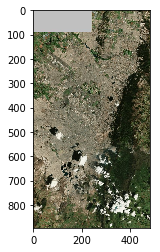

In [6]:
# Leer la imagen
img = io.imread("./data/dataset/train/satellite/13/zoom_13.jpg")

#Imprimir la imagen
plt.imshow(img)

In [4]:
# Dimension de la imagen
img.shape

(895, 481, 3)

# 3.2 ¿Como subdividir?

se quieren imagenes de poco mas de 512x256 y las iamgenes que se tienen son de distintos tamaños y algunas o la mayoria o incluso todas no son multiplos de 512 o 256, lo que genera la duda de como hacer la division de las imagnes a dicho tamaño. de aqui que me surgen 3 ideas para dividir el dataset
* Dividirlo y dejar sobrando pixeles
* sobrelapar las subimagenes
* agrandar las imagenes y que queden multiplos de 512

será algo a discutir con los profes.

**RTA:** Hablando con el profe fabio me recomendo que hiciera la subdivision haicendo solapamiento y el lo hice fue de a mitad osea en la mitad de un parche inicia el sigeinte parche no se que tan conveniente sea eso o hacerlo como estaba planeado de hacer casar el solapamiento, lo que haria obvio que no todas las imagnes tengan el mismo porcentaje de solapamiento lo que podria hablar con raul por que yo quede como wtf!! que hacer. si esperar a ver si raul me contesta si no mañaan empieza a sacar lo de solapamiento como me dijo fabio.

In [7]:
img_size_train = content_train['satellite_size']
# Dimensiones de las imagenes en el dataset, segun el zoom
img_size_train

0      481x895
1     962x1789
2    1922x3576
3    1921x3575
4    2560x4767
5    3072x5720
6    3072x5720
7    3840x7150
8    4915x9153
Name: satellite_size, dtype: object

In [8]:
img_size_train_int = [[int(j) for j in i.split("x")] for i in img_size_train]

# Dimensiones en string se necesita transformar en entero par ausarlo en la funcion de division, para hacerla mas general
img_size_train_int

[[481, 895],
 [962, 1789],
 [1922, 3576],
 [1921, 3575],
 [2560, 4767],
 [3072, 5720],
 [3072, 5720],
 [3840, 7150],
 [4915, 9153]]

In [93]:
sizeX, sizeY = 512, 256

print("PIXELES SOBRANTES AL DIVIDIR LA IMAGEN EN ", sizeX, "x", sizeY, "SIN HACER SOLAPAMIENTO")
count_img_train_div = [[int(i[0]/sizeX), int(i[1]/sizeY)] for i in img_size_train_int]
pix_ex_img_train_div = [[i[0]%sizeX, i[1]%sizeY] for i in img_size_train_int]
print("Cantidad de subimagenes: ", count_img_train_div)
print("Pixeles sobrantes", pix_ex_img_train_div)

print("\n")

print("PIXELES SOBRANTES AL DIVIDIR LA IMAGEN EN ", sizeX, "x", sizeY, "HACIENDO SOLAPAMIENTO DEL 50%")
count_img_train_div_over = [[int(2*i[0]/sizeX)-1, int(2*i[1]/sizeY)-1] for i in img_size_train_int]
pix_ex_img_train_div_over = [[int(((2*i[0]/sizeX)-int(2*i[0]/sizeX)+1)*(sizeX/2)), int(((2*i[1]/sizeY)-int(2*i[1]/sizeY)+1)*(sizeY/2))] for i in img_size_train_int]
print("Cantidad de subimagenes: ", count_img_train_div_over)
print("Pixeles sobrantes", pix_ex_img_train_div_over)

PIXELES SOBRANTES AL DIVIDIR LA IMAGEN EN  512 x 256 SIN HACER SOLAPAMIENTO
Cantidad de subimagenes:  [[0, 3], [1, 6], [3, 13], [3, 13], [5, 18], [6, 22], [6, 22], [7, 27], [9, 35]]
Pixeles sobrantes [[481, 127], [450, 253], [386, 248], [385, 247], [0, 159], [0, 88], [0, 88], [256, 238], [307, 193]]


PIXELES SOBRANTES AL DIVIDIR LA IMAGEN EN  512 x 256 HACIENDO SOLAPAMIENTO DEL 50%
Cantidad de subimagenes:  [[0, 5], [2, 12], [6, 26], [6, 26], [9, 36], [11, 43], [11, 43], [14, 54], [18, 70]]
Pixeles sobrantes [[481, 255], [450, 253], [386, 248], [385, 247], [256, 159], [256, 216], [256, 216], [256, 238], [307, 193]]


Hable con raul y me dijo que el solapamiento era mejor hacerlo en porcentajes y que mejor poner entre un 10 o 20% contrario al 50% que me insinuo el profe fabio, asi que buscare un algoritmo que ya haga esta extraccion de parches, si no pues hacerlo.

# 3.3 Extraccion de parches
la idea es sacar parches con solapamiento del 10 o 20% NOTA: no lo encontre en internet tan facilmente y pa ponerme a hacer una super busqueda en internet como que mejor lo hago yo.

(3575, 1921, 3)


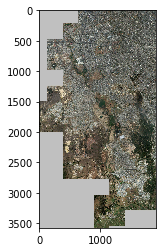

In [5]:
img_to_extract = io.imread("./data/dataset/train/satellite/16/zoom_16_1-2.jpg")
plt.imshow(img_to_extract)
print(img_to_extract.shape)

![HW](./vector/H_and_W.svg)

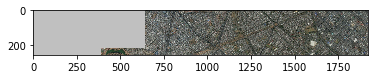

In [8]:
test_img = img_to_extract[0:256,:,:]
plt.imshow(test_img)

In [9]:
PATCH_PER = 50
PATCH_W = 512
PATCH_H = 256

IMG_W = test_img.shape[1]

N_W = int((100*IMG_W)/(PATCH_W*(100-PATCH_PER))) # number of patch for width
N_W

7

( 0 , 512 )
( 256 , 768 )
( 512 , 1024 )
( 768 , 1280 )
( 1024 , 1536 )
( 1280 , 1792 )
pixeles sobrantes: 385


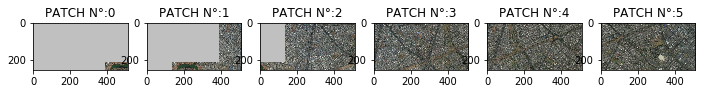

In [56]:
init_patch = 0
end_patch = PATCH_W

fig = plt.figure(figsize=(20,1))

for i in range(N_W):
    if(end_patch <= IMG_W):
        ax=fig.add_subplot(1,10,i+1)
        print("(",init_patch,",",end_patch,")")
        plt.imshow(test_img[:,init_patch:end_patch,:])

        init_patch = end_patch - int((PATCH_PER/100)*PATCH_W)
        end_patch = init_patch + PATCH_W

        ax.set_title("PATCH N°:" + str(i))
    else:
        print("pixeles sobrantes:" ,IMG_W-init_patch)

In [14]:
def extract_patch(img, patch_w, patch_h, patch_per):
    
    img_h = img.shape[0]
    img_w = img.shape[1]
    
    patchs = []
    
    count_w = 0
    count_h = 0
    
    nw = int((100*img_w)/(patch_w*(100-patch_per)))
    nh = int((100*img_h)/(patch_h*(100-patch_per)))
    
    
    
    init_patch_h = 0
    end_patch_h = patch_h
    
    for i in range(nh):
        
        if(end_patch_h <= img_h):   
            init_patch_w = 0
            end_patch_w = patch_w
            count_h = count_h+1

            for j in range(nw):
                if(end_patch_w <= img_w): 
                    patchs.append(img[init_patch_h:end_patch_h,init_patch_w:end_patch_w,:])
                    init_patch_w = end_patch_w - int((patch_per/100)*patch_w)
                    end_patch_w = init_patch_w + patch_w
                else:
                    pass
        
        
            init_patch_h = end_patch_h - int((patch_per/100)*patch_h)
            end_patch_h = init_patch_h + patch_h
        else:
            print("pixeles sobrantes W:" ,img_w-init_patch_w)
            print("pixeles sobrantes H:" ,img_h-init_patch_h)
    
    return patchs, count_h, int(len(patchs)/count_h) 

In [7]:
patchs_test, NH, NW = extract_patch(img_to_extract, 512, 256, 50)

pixeles sobrantes W: 385
pixeles sobrantes H: 247


In [154]:
len(patchs_test), NH, NW

(156, 26, 6)

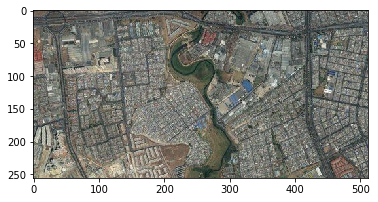

In [52]:
plt.imshow(patchs_test[25])

Comprobamos de que la extracion se hizo correctamente

#### Imagen Completa:

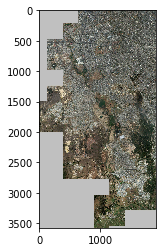

In [53]:
plt.imshow(img_to_extract)

#### Parches de la imagen

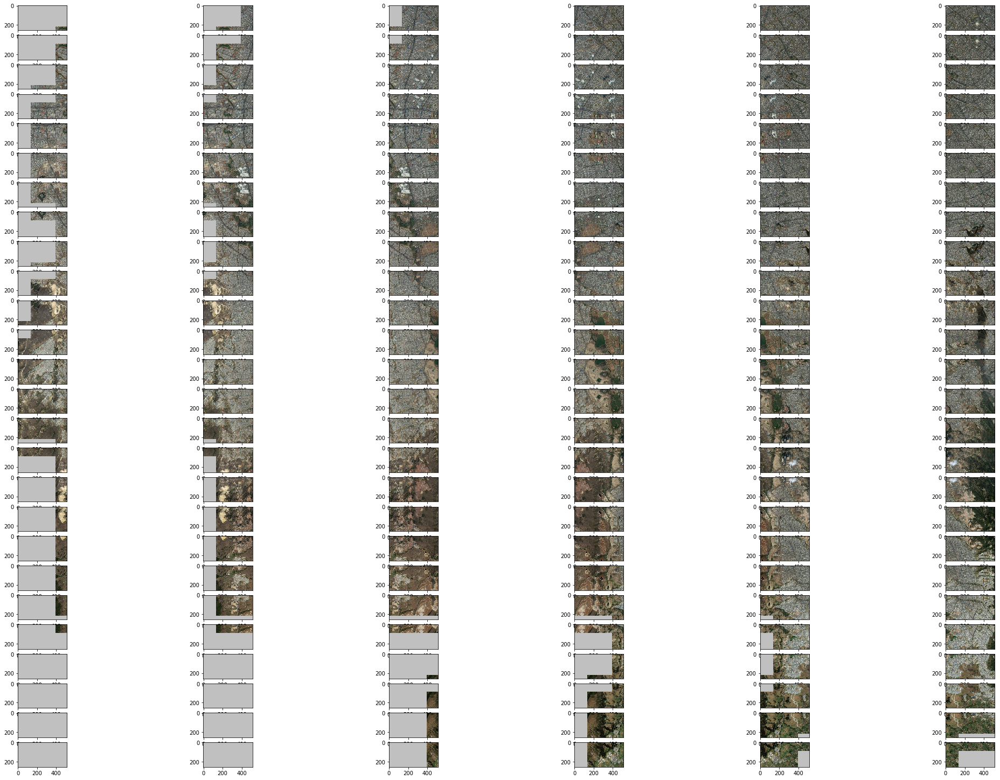

In [59]:
fig = plt.figure(figsize=(NW+30,NH))

for j,i in enumerate(patchs_test):
    ax=fig.add_subplot(NH,NW,j+1)
    plt.imshow(i)

In [15]:
def save_patchs(fname, patchs, aux):
    for j,i in enumerate(patchs):
        plt.imsave(fname+str(aux+j),i, format="png")
        print("Imagen guarda", fname+str(aux+j)+".png")

In [91]:
save_patchs("./data/dataset/overlap/train/", patchs_test)

Imagen guarda ./data/dataset/overlap/train/0.png
Imagen guarda ./data/dataset/overlap/train/1.png
Imagen guarda ./data/dataset/overlap/train/2.png
Imagen guarda ./data/dataset/overlap/train/3.png
Imagen guarda ./data/dataset/overlap/train/4.png
Imagen guarda ./data/dataset/overlap/train/5.png
Imagen guarda ./data/dataset/overlap/train/6.png
Imagen guarda ./data/dataset/overlap/train/7.png
Imagen guarda ./data/dataset/overlap/train/8.png
Imagen guarda ./data/dataset/overlap/train/9.png
Imagen guarda ./data/dataset/overlap/train/10.png
Imagen guarda ./data/dataset/overlap/train/11.png
Imagen guarda ./data/dataset/overlap/train/12.png
Imagen guarda ./data/dataset/overlap/train/13.png
Imagen guarda ./data/dataset/overlap/train/14.png
Imagen guarda ./data/dataset/overlap/train/15.png
Imagen guarda ./data/dataset/overlap/train/16.png
Imagen guarda ./data/dataset/overlap/train/17.png
Imagen guarda ./data/dataset/overlap/train/18.png
Imagen guarda ./data/dataset/overlap/train/19.png
Imagen gua

# 3.4 Extraccion de parches REAL.

In [3]:
PATHS = ["train","test"]
TYPES = ["layer_economic", "satellite"]
ZOOMS = ["13","14","15","16","17","18","19","20","21"]

!ls {PATH_DATASET}/{PATHS[0]}/{TYPES[0]}/{ZOOMS[5]}

zoom_layer_18_1-3.jpg  zoom_layer_18_3-2.jpg  zoom_layer_18_4-3.jpg
zoom_layer_18_1-4.jpg  zoom_layer_18_3-3.jpg  zoom_layer_18_4-4.jpg
zoom_layer_18_1-5.jpg  zoom_layer_18_3-4.jpg  zoom_layer_18_5-1.jpg
zoom_layer_18_2-3.jpg  zoom_layer_18_3-5.jpg  zoom_layer_18_5-2.jpg
zoom_layer_18_2-4.jpg  zoom_layer_18_4-1.jpg
zoom_layer_18_2-5.jpg  zoom_layer_18_4-2.jpg


In [16]:
all_imgs = []

for path in PATHS:
    
    for tipe in TYPES:
        
        
        for zoom in ZOOMS:            
            imgs = !ls {PATH_DATASET}/{path}/{tipe}/{zoom}
            
           
            for j,img in enumerate(imgs):
                aux = 100000000
                aux = aux*(j+1)
                print(img)
                img_to_extract = io.imread(PATH_DATASET+"/"+path+"/"+tipe+"/"+zoom+"/"+img)
                patchs, _, _ = extract_patch(img_to_extract, 256, 256, 20)
                print(aux)
                save_patchs("./data/dataset/overlap/"+path+"/"+tipe+"/"+zoom+"/", patchs, aux)
                
                #all_imgs.append(img)
            

zoom_layer_21_10-11.jpg
100000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000144.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000259.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000374.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000489.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000605.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000722.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000848.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/100000976.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000077.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000188.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000299.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000413.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000527.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000655.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000784.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200000910.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/200001011.png
zoom_layer_21_10-13.jpg
300000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/30000

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000128.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000245.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000363.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000479.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000606.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000733.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000856.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/300000969.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000080.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000081.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000082.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000202.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000331.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000444.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000555.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000670.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000785.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/400000896.png
Imagen guarda ./data/data

500000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000012.png
Imagen guarda .

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000127.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000254.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000380.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000505.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000621.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000736.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000865.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/500000992.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000100.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000210.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000323.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000436.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000553.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000669.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000783.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600000895.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/600001011.png
zoom_layer_21_10-17.jpg
700000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/70000

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000141.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000255.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000371.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000487.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000602.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000720.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000832.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/700000959.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000066.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000178.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000293.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000416.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000536.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000655.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000765.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000886.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/800001003.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000105.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000113.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000232.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000361.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000490.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000620.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000735.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000856.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/900000979.png
Imagen guarda ./data/data

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000080.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000081.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000082.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000083.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000192.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000302.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000419.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000527.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000635.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000757.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000871.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1000000990.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000097.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000217.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000336.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000446.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000571.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000694.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000814.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1100000930.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000018.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000019.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000030.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000148.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000270.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000381.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000492.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000619.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000732.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000853.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1200000962.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000064.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000173.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000284.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000396.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000509.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000631.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000743.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000868.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1300000977.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000074.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000202.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000313.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000429.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000555.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000670.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000779.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000899.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1400001010.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000105.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000111.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000226.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000348.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000476.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000585.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000709.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000818.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1500000930.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000033.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000160.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000274.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000399.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000527.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000653.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000777.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600000904.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1600001011.png
zoom_layer_21_11-13.jpg
1700000000
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000105.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000114.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000231.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000354.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000468.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000581.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000689.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000816.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1700000935.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000033.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000145.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000269.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000378.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000490.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000615.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000740.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000866.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1800000991.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000080.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000081.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000082.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000092.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000200.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000314.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000435.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000559.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000669.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000787.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/1900000912.png
Imagen guard

2000000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000012.png
I

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000129.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000247.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000368.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000493.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000604.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000728.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000852.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2000000976.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000080.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000081.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000082.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000084.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000207.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000329.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000437.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000548.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000657.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000771.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100000891.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2100001011.png
zoom_layer_21_11-18.jpg
2200000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000005.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000119.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000235.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000344.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000453.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000583.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000699.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000813.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2200000930.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000144.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000263.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000391.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000500.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000626.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000737.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000847.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2300000963.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000061.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000180.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000295.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000411.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000522.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000650.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000765.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000877.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2400001002.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000105.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000114.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000240.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000349.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000475.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000583.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000708.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000827.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2500000944.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000055.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000164.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000272.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000397.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000511.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000619.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000730.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000842.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2600000957.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000057.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000167.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000284.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000403.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000524.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000635.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000745.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000854.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2700000970.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000080.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000194.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000309.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000421.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000535.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000648.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000759.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000872.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2800000987.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000101.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000216.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000331.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000446.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000559.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000675.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000791.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900000907.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/2900001011.png
zoom_layer_21_12-11.jpg
3000000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000010.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000127.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000243.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000359.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000474.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000585.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000700.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000816.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3000000939.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000055.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000168.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000281.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000396.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000513.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000630.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000743.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000859.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3100000974.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000080.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000188.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000296.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000406.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000516.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000633.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000746.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000854.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3200000977.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000074.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000189.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000302.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000428.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000555.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000664.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000774.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300000883.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3300001011.png
zoom_layer_21_12-15.jpg
3400000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000000.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000120.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000228.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000339.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000449.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000572.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000685.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000796.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3400000920.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000158.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000283.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000393.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000504.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000614.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000735.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000863.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3500000979.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000082.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000094.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000217.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000340.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000454.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000579.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000692.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000817.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3600000944.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000040.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000052.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000177.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000286.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000394.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000509.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000622.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000744.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000864.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3700000972.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000069.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000180.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000290.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000419.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000531.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000641.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000749.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000864.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3800000974.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000073.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000199.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000314.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000436.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000546.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000657.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000770.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000880.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/3900000994.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000101.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000214.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000326.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000436.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000551.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000667.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000783.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000897.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4000001007.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000103.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000213.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000321.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000442.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000571.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000684.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000811.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4100000942.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000054.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000169.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000278.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000388.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000504.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000620.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000734.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000849.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4200000963.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000079.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000192.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000307.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000420.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000536.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000659.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000771.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000888.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4300001008.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000105.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000221.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000336.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000452.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000563.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000684.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000795.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4400000906.png
Imagen guard

4500000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000012.png
I

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000123.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000238.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000353.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000462.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000574.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000690.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000805.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4500000915.png
Imagen guard

4600000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000012.png
I

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000120.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000230.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000343.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000455.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000570.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000685.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000804.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4600000913.png
Imagen guard

4700000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000012.png
I

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000137.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000255.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000382.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000498.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000611.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000724.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000832.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4700000945.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000057.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000169.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000299.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000414.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000524.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000638.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000753.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000869.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4800000986.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000100.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000210.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000321.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000431.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000543.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000652.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000760.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000869.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/4900000985.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000102.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000217.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000338.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000459.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000575.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000691.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000802.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5000000914.png
Imagen guard

5100000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000012.png
I

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000136.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000246.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000360.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000485.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000599.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000711.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000824.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5100000937.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000146.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000257.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000368.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000481.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000593.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000708.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000821.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5200000938.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000162.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000271.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000387.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000505.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000620.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000734.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000851.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5300000974.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000077.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000189.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000303.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000416.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000543.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000651.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000767.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000881.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5400000997.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000101.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000210.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000319.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000432.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000549.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000659.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000775.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000891.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5500001009.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000126.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000244.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000353.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000468.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000576.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000701.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000830.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5600000945.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000057.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000171.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000279.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000404.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000515.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000631.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000745.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000861.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5700000977.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000080.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000203.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000314.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000433.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000563.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000687.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000797.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800000912.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5800001011.png
zoom_layer_21_14-13.jpg
5900000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000007.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000119.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000230.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000355.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000483.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000595.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000710.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000826.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/5900000940.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000054.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000167.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000275.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000383.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000494.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000602.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000721.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000830.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6000000956.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000055.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000179.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000307.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000419.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000545.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000658.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000771.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000885.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6100000998.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000098.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000210.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000322.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000436.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000548.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000661.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000771.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000884.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6200000992.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000080.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000081.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000082.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000089.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000199.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000312.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000423.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000549.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000664.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000781.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300000909.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6300001011.png
zoom_layer_21_14-18.jpg
6400000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000010.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000126.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000240.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000353.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000464.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000575.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000684.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000796.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400000910.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6400001011.png
zoom_layer_21_14-19.jpg
6500000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000008.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000123.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000233.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000343.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000460.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000573.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000683.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000799.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6500000924.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000147.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000259.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000370.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000480.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000593.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000708.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000818.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6600000928.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000151.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000273.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000389.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000515.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000629.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000743.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000873.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6700000988.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000102.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000211.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000321.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000433.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000548.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000661.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000773.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000883.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6800000999.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000099.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000211.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000324.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000437.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000553.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000667.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000793.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/6900000918.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000151.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000259.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000376.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000488.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000597.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000712.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000827.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7000000945.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000057.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000173.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000289.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000401.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000515.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000628.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000744.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000853.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7100000967.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000080.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000190.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000303.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000424.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000534.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000645.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000769.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000883.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7200000995.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000095.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000223.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000332.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000447.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000558.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000672.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000783.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000896.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7300001006.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000104.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000221.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000331.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000442.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000554.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000663.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000775.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000886.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7400000997.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000101.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000211.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000325.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000450.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000569.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000691.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000799.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7500000911.png
Imagen guard

7600000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000012.png
I

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000140.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000249.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000357.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000478.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000586.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000715.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000824.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7600000942.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000039.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000040.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000051.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000162.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000289.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000403.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000512.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000620.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000746.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000854.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7700000963.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000073.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000181.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000289.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000401.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000512.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000620.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000729.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000838.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7800000948.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000056.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000169.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000298.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000410.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000521.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000634.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000746.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000870.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/7900000995.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000105.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000227.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000349.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000460.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000576.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000698.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000807.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8000000934.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000149.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000263.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000389.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000501.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000610.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000722.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000832.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8100000943.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000057.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000172.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000284.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000401.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000511.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000623.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000736.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000846.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8200000954.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000040.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000052.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000164.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000293.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000420.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000529.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000639.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000767.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000882.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8300000994.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000098.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000216.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000325.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000436.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000544.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000671.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000801.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400000911.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8400001011.png
zoom_layer_21_15-23.jpg
8500000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000008.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000118.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000246.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000359.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000482.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000598.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000709.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000820.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8500000934.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000034.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000149.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000265.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000380.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000495.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000607.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000721.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000831.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8600000961.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000076.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000206.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000319.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000432.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000558.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000672.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000799.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8700000907.png
Imagen guard

8800000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000012.png
I

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000133.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000255.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000382.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000511.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000641.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000766.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000882.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8800000995.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000098.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000211.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000339.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000467.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000591.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000712.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000823.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/8900000952.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000055.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000185.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000297.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000413.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000521.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000645.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000767.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000876.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9000000985.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000080.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000081.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000193.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000305.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000427.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000548.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000673.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000784.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100000910.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9100001011.png
zoom_layer_21_16-13.jpg
9200000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000008.png
Imagen guarda ./data/dataset/overlap/train/layer_econ

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000119.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000227.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000342.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000456.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000568.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000692.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000819.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9200000930.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000032.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000154.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000279.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000388.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000510.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000620.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000731.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000855.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9300000969.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000076.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000185.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000308.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000435.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000562.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000680.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000803.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9400000920.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000033.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000147.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000267.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000387.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000508.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000628.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000739.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000852.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9500000970.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000079.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000202.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000315.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000441.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000571.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000684.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000808.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9600000919.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000016.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000017.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000018.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000019.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000028.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000152.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000269.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000382.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000496.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000607.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000719.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000828.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9700000942.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000034.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000035.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000036.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000037.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000038.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000039.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000151.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000261.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000371.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000481.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000610.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000735.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000856.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9800000986.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000099.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000226.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000334.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000461.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000590.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000709.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000836.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/9900000944.png
Imagen guard

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000054.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000177.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000306.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000416.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000530.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000644.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000751.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000875.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10000000999.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000097.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000225.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000334.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000454.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000567.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000691.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000818.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10100000937.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000038.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000039.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000040.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000050.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000172.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000284.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000399.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000513.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000620.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000733.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000861.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10200000969.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000073.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000197.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000310.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000418.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000544.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000671.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000784.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000892.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10300001000.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000099.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000211.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000335.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000443.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000552.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000662.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000779.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000897.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10400001004.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000099.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000228.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000349.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000462.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000586.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000710.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000833.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10500000955.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000054.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000179.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000302.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000428.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000547.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000663.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000791.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10600000898.png

10700000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/107

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000119.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000229.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000353.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000465.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000580.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000696.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000817.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10700000946.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000054.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000165.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000291.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000404.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000521.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000635.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000751.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000861.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10800000986.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000095.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000205.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000329.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000440.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000557.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000666.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000775.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900000902.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/10900001011.png
zoom_layer_21_17-6.jpg
11000000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000001.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000124.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000249.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000377.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000490.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000597.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000704.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000832.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11000000962.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000189.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000299.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000426.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000553.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000674.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000795.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11100000921.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000018.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000019.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000030.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000153.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000271.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000379.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000491.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000614.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000722.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000838.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11200000951.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000040.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000052.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000163.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000272.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000384.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000495.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000608.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000722.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000829.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11300000939.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000038.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000039.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000040.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000050.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000159.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000275.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000390.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000499.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000608.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000721.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000834.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11400000943.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000055.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000168.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000279.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000401.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000515.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000630.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000747.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000866.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11500000988.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000096.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000206.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000315.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000442.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000550.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000664.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000775.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600000897.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11600001011.png
zoom_layer_21_18-4.jpg
11700000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000006.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000105.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000116.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000231.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000343.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000461.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000578.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000704.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000813.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11700000924.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000018.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000019.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000030.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000153.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000276.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000389.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000499.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000607.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000728.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000835.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11800000960.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000065.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000182.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000297.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000404.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000514.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000637.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000747.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000854.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/11900000969.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000079.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000193.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000307.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000435.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000551.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000665.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000780.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12000000906.png

12100000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/121

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000140.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000249.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000366.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000487.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000602.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000729.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000842.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12100000966.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000080.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000190.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000300.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000424.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000547.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000671.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000783.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12200000908.png

12300000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/123

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000133.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000259.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000377.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000497.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000613.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000732.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000851.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12300000960.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000063.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000181.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000303.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000426.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000536.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000654.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000762.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000882.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12400000991.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000099.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000226.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000349.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000464.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000576.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000693.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000800.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500000909.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12500001011.png
zoom_layer_21_19-4.jpg
12600000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000009.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000121.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000232.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000355.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000482.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000596.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000718.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000839.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12600000964.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000063.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000176.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000286.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000403.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000519.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000629.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000750.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000873.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12700000997.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000081.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000082.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000093.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000203.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000328.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000438.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000566.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000689.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000811.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12800000932.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000150.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000278.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000386.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000510.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000621.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000749.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000860.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/12900000968.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000067.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000185.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000294.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000416.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000538.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000658.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000783.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13000000906.png

13100000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/131

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000130.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000247.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000368.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000494.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000614.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000733.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000844.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13100000962.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000057.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000058.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000059.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000060.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000063.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000189.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000299.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000407.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000516.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000626.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000736.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000858.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13200000972.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000076.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000190.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000316.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000429.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000540.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000665.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000792.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13300000908.png

13400000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/134

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000136.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000258.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000374.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000486.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000609.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000718.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000828.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13400000940.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000034.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000035.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000036.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000037.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000158.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000265.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000380.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000487.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000594.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000716.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000840.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13500000952.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000056.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000167.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000281.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000392.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000520.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000635.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000751.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000867.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13600000983.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000079.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000197.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000311.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000427.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000538.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000652.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000768.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000876.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13700000992.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000104.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000215.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000325.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000432.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000551.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000671.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000797.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13800000921.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000018.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000019.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000030.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000153.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000274.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000397.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000525.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000633.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000743.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000850.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/13900000958.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000053.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000180.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000290.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000412.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000539.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000648.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000756.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000879.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14000000986.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000099.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000224.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000332.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000441.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000549.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000657.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000780.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100000909.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14100001011.png
zoom_layer_21_21-1.jpg
14200000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000008.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000241.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000355.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000467.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000580.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000695.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000809.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14200000924.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000033.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000145.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000259.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000373.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000487.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000601.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000715.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000830.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14300000941.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000057.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000172.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000288.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000416.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000528.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000640.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000750.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000860.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14400000975.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000207.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000323.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000439.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000554.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000669.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000782.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000896.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14500001010.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000104.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000218.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000331.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000446.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000562.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000675.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000790.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600000907.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14600001011.png
zoom_layer_21_21-5.jpg
14700000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000008.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000124.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000240.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000351.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000460.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000574.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000686.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000793.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700000904.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14700001011.png
zoom_layer_21_2-16.jpg
14800000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000002.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000236.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000343.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000450.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000562.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000677.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000791.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800000903.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14800001011.png
zoom_layer_21_21-6.jpg
14900000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000005.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000237.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000348.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000462.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000572.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000685.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000798.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/14900000913.png

15000000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/150

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000235.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000346.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000458.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000570.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000682.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000809.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15000000919.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000150.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000269.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000386.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000501.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000617.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000732.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000845.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15100000961.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000056.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000169.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000285.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000398.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000509.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000620.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000731.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000845.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15200000959.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000057.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000170.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000285.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000400.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000515.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000628.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000738.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000853.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15300000965.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000188.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000302.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000415.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000530.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000638.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000745.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000860.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15400000968.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000080.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000196.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000312.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000428.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000545.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000659.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000770.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000880.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15500000992.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000101.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000215.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000327.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000441.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000554.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000669.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000781.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000893.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15600001009.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000103.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000216.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000325.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000439.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000551.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000664.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000775.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000887.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15700001000.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000102.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000221.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000331.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000444.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000559.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000672.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000787.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000895.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15800001010.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000104.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000219.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000331.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000440.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000552.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000678.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000788.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000896.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/15900001007.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000121.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000232.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000345.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000456.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000570.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000680.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000796.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000000906.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16000001011.png
zoom_layer_21_22-7.jpg
16100000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000009.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000118.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000228.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000336.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000446.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000557.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000683.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000799.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16100000914.png

16200000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/162

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000242.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000359.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000475.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000591.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000708.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000824.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16200000940.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000151.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000264.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000380.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000496.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000608.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000722.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000836.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16300000951.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000055.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000169.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000283.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000400.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000515.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000628.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000746.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000865.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16400000977.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000077.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000189.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000304.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000419.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000535.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000650.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000765.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000877.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16500000989.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000102.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000217.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000332.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000444.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000556.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000670.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000784.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000899.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16600001011.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000241.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000355.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000466.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000580.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000690.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000801.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16700000917.png

16800000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/168

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000235.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000347.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000457.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000567.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000677.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000786.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800000900.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16800001011.png
zoom_layer_21_23-7.jpg
16900000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000000.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000127.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000239.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000354.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000470.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000585.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000700.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000814.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/16900000929.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000150.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000264.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000382.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000498.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000613.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000728.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000841.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17000000955.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000057.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000173.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000290.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000405.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000516.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000626.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000749.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000858.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17100000985.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000100.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000213.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000330.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000445.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000560.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000677.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000793.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200000908.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17200001011.png
zoom_layer_21_24-2.jpg
17300000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000010.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000253.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000368.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000484.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000597.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000710.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000825.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17300000940.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000149.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000262.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000369.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000482.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000596.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000703.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000813.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17400000927.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000149.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000264.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000379.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000494.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000607.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000715.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000830.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17500000943.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000056.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000171.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000288.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000403.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000517.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000627.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000742.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000857.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17600000967.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000080.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000197.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000312.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000427.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000538.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000649.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000764.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000879.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17700000991.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000101.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000216.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000328.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000457.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000571.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000687.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000800.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800000907.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17800001011.png
zoom_layer_21_25-3.jpg
17900000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000005.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000122.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000233.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000341.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000454.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000569.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000685.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000801.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/17900000916.png

18000000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/180

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000127.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000242.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000355.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000465.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000576.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000699.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000807.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000808.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000817.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18000000935.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000018.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000019.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000030.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000138.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000241.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000245.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000362.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000475.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000587.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000702.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000829.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18100000955.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000055.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000165.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000277.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000389.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000497.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000610.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000717.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000834.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18200000942.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000053.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000177.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000301.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000421.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000532.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000640.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000766.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000875.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18300000984.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000080.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000188.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000295.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000406.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000522.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000634.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000758.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000865.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18400000990.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000103.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000210.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000338.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000452.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000566.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000679.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000789.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18500000916.png

18600000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/186

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000121.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000231.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000357.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000467.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000577.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000688.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000799.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600000910.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18600001011.png
zoom_layer_21_3-20.jpg
18700000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000007.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000125.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000241.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000356.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000470.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000580.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000708.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000809.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000821.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18700000936.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000150.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000260.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000372.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000486.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000600.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000714.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000822.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18800000935.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000147.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000262.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000378.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000493.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000607.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000724.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000838.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/18900000948.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000055.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000168.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000282.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000393.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000509.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000625.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000740.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000849.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19000000956.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000055.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000169.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000295.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000422.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000532.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000639.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000748.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000856.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19100000970.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000192.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000303.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000410.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000521.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000629.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000738.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000853.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19200000966.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000061.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000073.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000184.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000310.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000434.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000545.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000655.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000766.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000884.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19300000998.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000095.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000204.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000317.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000446.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000557.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000669.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000782.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000894.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19400001007.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000103.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000218.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000334.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000450.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000566.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000677.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000790.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500000901.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19500001011.png
zoom_layer_21_5-15.jpg
19600000000
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000124.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000239.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000354.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000467.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000582.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000694.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000803.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19600000925.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000033.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000144.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000255.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000372.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000488.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000603.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000718.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000832.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19700000948.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000056.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000165.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000287.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000288.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000289.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000292.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000407.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000518.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000632.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000745.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000857.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19800000968.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000080.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000193.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000304.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000417.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000529.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000657.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000769.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000894.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/19900001001.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000097.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000210.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000326.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000441.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000554.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000664.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000780.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000895.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20000001009.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000123.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000238.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000355.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000465.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000578.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000691.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000806.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000918.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20100000921.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000020.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000032.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000147.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000258.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000373.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000484.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000594.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000695.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000702.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000830.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20200000955.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000057.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000172.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000285.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000286.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000287.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000398.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000399.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000400.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000401.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000402.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000517.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000631.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000746.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000861.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20300000975.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000076.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000189.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000302.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000416.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000514.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000515.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000516.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000523.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000632.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000745.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000857.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20400000966.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000205.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000314.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000424.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000537.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000648.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000761.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000870.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20500000978.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000074.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000202.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000330.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000442.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000556.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000670.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000781.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000889.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20600001000.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000103.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000218.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000331.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000447.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000560.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000672.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000781.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000889.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20700001002.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000100.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000207.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000320.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000432.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000546.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000661.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000770.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000884.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20800000992.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000096.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000210.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000318.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000429.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000542.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000670.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000780.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000893.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/20900001004.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000101.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000215.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000324.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000438.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000553.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000669.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000784.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000888.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000889.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000890.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000899.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21000001011.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000124.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000240.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000353.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000466.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000468.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000579.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000580.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000581.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000583.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000693.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000804.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000805.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000806.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000807.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21100000915.png

21200000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/212

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000121.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000230.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000337.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000452.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000575.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000685.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000797.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200000906.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21200001011.png
zoom_layer_21_7-15.jpg
21300000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000001.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000103.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000104.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000105.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000106.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000107.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000108.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000109.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000110.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000114.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000222.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000343.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000466.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000582.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000583.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000584.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000585.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000594.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000696.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000697.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000698.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000708.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000824.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21300000931.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000150.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000261.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000365.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000366.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000371.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000485.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000586.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000587.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000588.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000598.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000712.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000810.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000811.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000812.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000813.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000814.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000822.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000931.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000932.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000933.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000934.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000935.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21400000937.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000033.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000034.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000148.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000151.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000267.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000380.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000495.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000607.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000722.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000837.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21500000954.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000057.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000169.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000281.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000395.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000509.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000624.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000739.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000854.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21600000969.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000079.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000194.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000309.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000424.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000540.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000653.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000770.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000885.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21700001000.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000102.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000219.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000334.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000450.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000565.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000680.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000796.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21800000913.png

21900000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000011.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/219

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000111.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000112.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000113.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000123.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000238.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000353.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000467.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000468.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000469.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000470.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000471.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000472.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000473.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000474.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000475.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000476.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000477.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000479.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000602.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000699.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000700.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000701.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000702.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000711.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000835.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/21900000959.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000056.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000164.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000274.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000398.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000507.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000614.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000725.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000835.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22000000950.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000041.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000042.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000053.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000149.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000150.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000151.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000152.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000161.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000269.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000367.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000379.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000494.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000606.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000722.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000839.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22100000954.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000057.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000167.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000276.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000388.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000498.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000609.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000720.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000836.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22200000948.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000055.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000168.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000284.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000397.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000507.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000615.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000727.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000834.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22300000962.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000062.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000063.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000074.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000187.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000303.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000417.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000530.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000645.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000760.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000870.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000875.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000982.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000983.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000984.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000985.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000986.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22400000988.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000101.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000216.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000339.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000340.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000341.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000344.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000451.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000452.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000453.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000457.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000561.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000562.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000563.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000564.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000565.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000568.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000675.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000782.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500000906.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22500001011.png
zoom_layer_21_8-18.jpg
22600000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000009.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000241.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000356.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000466.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000566.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000578.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000676.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000677.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000678.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000679.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000680.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000681.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000682.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000688.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000790.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000791.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000802.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000906.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000907.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000908.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000909.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000910.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000911.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000912.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000913.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000914.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000915.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000916.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000917.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22600000918.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000033.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000145.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000146.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000147.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000148.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000261.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000262.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000263.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000265.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000368.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000369.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000370.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000371.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000372.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000373.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000374.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000380.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000490.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000491.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000495.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000601.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000602.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000603.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000604.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000605.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000715.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000716.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000720.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000833.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000936.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22700000948.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000056.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000057.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000168.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000169.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000170.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000171.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000172.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000173.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000174.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000276.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000277.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000278.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000279.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000280.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000281.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000282.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000283.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000284.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000285.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000390.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000391.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000392.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000393.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000394.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000395.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000396.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000397.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000398.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000512.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000513.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000514.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000618.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000619.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000620.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000621.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000622.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000623.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000624.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000625.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000627.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000733.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000734.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000742.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000856.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000953.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22800000965.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000079.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000080.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000192.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000193.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000195.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000308.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000423.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000538.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000653.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000768.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000871.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000883.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/22900000999.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000081.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000082.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000083.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000084.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000093.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000194.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000195.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000196.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000206.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000320.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000431.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000543.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000659.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000771.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000886.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23000000999.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000099.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000213.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000329.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000444.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000559.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000672.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000780.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000888.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23100001002.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000085.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000086.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000087.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000088.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000089.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000097.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000197.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000198.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000199.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000200.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000201.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000202.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000203.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000204.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000209.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000316.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000323.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000435.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000548.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000661.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000774.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000886.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000887.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000888.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23200001007.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000102.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000218.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000330.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000427.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000428.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000429.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000430.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000439.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000543.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000544.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000548.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000655.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000770.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000771.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000772.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000773.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000774.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000779.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000903.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000904.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000905.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300000906.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23300001011.png
zoom_layer_21_9-14.jpg
23400000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000001.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000009.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000126.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000127.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000128.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000129.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000130.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000131.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000132.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000135.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000254.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000255.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000256.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000257.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000258.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000259.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000260.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000261.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000375.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000376.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000387.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000506.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000507.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000508.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000509.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000510.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000511.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000512.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000626.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000627.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000628.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000629.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000630.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000638.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000735.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000736.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000737.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000738.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000739.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000740.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000741.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000747.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000850.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000851.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000852.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000853.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000855.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000954.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23400000966.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000174.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000175.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000176.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000186.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000313.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000427.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000538.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000648.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000754.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000755.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000756.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000758.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000854.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000866.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000967.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000968.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000969.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23500000974.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000189.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000290.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000291.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000292.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000293.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000302.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000402.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000403.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000404.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000405.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000406.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000407.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000408.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000409.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000414.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000517.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000518.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000519.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000520.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000529.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000643.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000754.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000867.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000868.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000869.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000870.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23600000982.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000064.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000065.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000076.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000190.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000294.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000295.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000306.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000410.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000411.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000422.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000521.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000522.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000523.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000524.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000525.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000526.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000533.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000631.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000632.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000633.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000634.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000635.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000636.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000637.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000638.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000639.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000640.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000641.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000643.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000742.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000743.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000744.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000745.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000746.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000747.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000748.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000749.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000750.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000751.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000752.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000753.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000754.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000855.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000856.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000857.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000858.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000859.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000860.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000861.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000862.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000863.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000864.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000865.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000866.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000867.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000970.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000971.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000972.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000973.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000974.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000975.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000976.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000977.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000978.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000979.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000980.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000981.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23700000982.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000078.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000079.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000177.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000178.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000179.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000189.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000308.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000309.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000310.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000311.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000312.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000313.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000314.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000315.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000316.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000424.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000425.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000426.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000427.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000539.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000540.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000541.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000542.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000543.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000654.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000655.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000656.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000657.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000658.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000659.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000769.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000770.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000884.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000885.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000886.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000987.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23800000999.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000102.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000103.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000217.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000218.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000219.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000220.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000221.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000222.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000223.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000224.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000225.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000226.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000227.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000228.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000229.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000329.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000330.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000331.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000332.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000333.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000334.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000335.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000336.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000337.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000338.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000339.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000443.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000444.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000445.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000446.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000447.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000448.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000449.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000450.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000451.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000557.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000558.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000559.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000560.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000561.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000671.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000672.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000673.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000674.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000675.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000676.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000787.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000788.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000789.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000790.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900000903.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001002.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001003.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001004.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001005.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/23900001011.png
zoom_layer_21_9-20.jpg
24000000000
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000000.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000001.png
Imagen guarda ./data/dataset/overlap/trai

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000114.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000115.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000116.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000117.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000118.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000119.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000120.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000121.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000122.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000123.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000124.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000125.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000126.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000229.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000230.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000231.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000232.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000233.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000234.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000235.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000236.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000237.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000238.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000239.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000240.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000241.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000342.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000343.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000344.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000345.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000346.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000347.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000348.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000349.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000350.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000351.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000352.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000354.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000454.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000455.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000456.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000457.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000458.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000459.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000460.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000461.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000462.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000463.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000464.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000465.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000466.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000567.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000568.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000569.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000570.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000571.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000572.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000573.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000574.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000575.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000576.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000577.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000578.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000579.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000683.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000684.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000685.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000686.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000687.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000688.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000689.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000690.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000691.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000692.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000693.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000694.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000695.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000792.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000793.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000794.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000795.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000796.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000797.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000798.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000799.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000800.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000801.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000802.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000803.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000804.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000919.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000920.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000921.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000922.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000923.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000924.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000925.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000926.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000927.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000928.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000929.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000930.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24000000931.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000021.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000022.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000023.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000024.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000025.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000026.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000027.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000028.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000029.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000030.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000031.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000032.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000033.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000133.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000134.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000135.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000136.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000137.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000138.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000139.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000140.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000141.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000142.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000143.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000144.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000145.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000242.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000243.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000244.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000245.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000246.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000247.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000248.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000249.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000250.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000251.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000252.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000253.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000254.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000353.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000354.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000355.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000356.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000357.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000358.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000359.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000360.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000361.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000362.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000363.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000364.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000365.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000478.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000479.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000480.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000481.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000482.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000483.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000484.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000485.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000486.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000487.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000488.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000489.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000490.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000589.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000590.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000591.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000592.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000593.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000594.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000595.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000596.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000597.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000598.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000599.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000600.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000601.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000703.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000704.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000705.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000706.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000707.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000708.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000709.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000710.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000711.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000712.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000713.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000714.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000715.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000815.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000816.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000817.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000818.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000819.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000820.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000821.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000822.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000823.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000824.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000825.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000827.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000949.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000950.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000951.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000952.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24100000953.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000055.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000056.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000165.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000166.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000167.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000168.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000276.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000377.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000389.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000492.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000493.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000504.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000605.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000617.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000717.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000718.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000719.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000720.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000729.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000826.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000827.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000828.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000829.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000830.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000831.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000832.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000833.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000834.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000835.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000836.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000837.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000838.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000937.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000938.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000939.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000940.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000941.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000942.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000943.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000944.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000945.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000946.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000947.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000948.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24200000949.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000043.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000044.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000045.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000046.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000047.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000048.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000049.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000050.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000051.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000052.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000053.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000054.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000055.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000153.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000154.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000155.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000156.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000157.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000158.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000159.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000160.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000161.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000162.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000163.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000164.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000165.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000264.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000265.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000266.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000267.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000268.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000269.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000270.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000271.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000272.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000273.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000274.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000275.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000276.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000378.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000379.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000380.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000381.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000382.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000383.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000384.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000385.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000386.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000387.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000388.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000389.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000390.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000494.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000495.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000496.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000497.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000498.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000499.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000500.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000501.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000502.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000503.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000504.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000505.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000506.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000606.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000607.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000608.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000609.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000610.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000611.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000612.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000613.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000614.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000615.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000616.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000617.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000618.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000721.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000722.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000723.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000724.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000725.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000726.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000727.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000728.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000729.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000730.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000731.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000732.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000733.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000838.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000839.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000840.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000841.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000842.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000843.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000844.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000845.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000846.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000847.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000848.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000849.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000850.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000955.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000956.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000957.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000958.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000959.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000960.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000961.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000962.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000963.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000964.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000965.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000966.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24300000967.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000066.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000067.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000068.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000069.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000070.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000071.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000072.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000073.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000074.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000075.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000076.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000077.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000078.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000180.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000181.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000182.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000183.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000184.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000185.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000186.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000187.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000188.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000189.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000190.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000191.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000192.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000296.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000297.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000298.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000299.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000300.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000301.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000302.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000303.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000304.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000305.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000306.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000307.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000308.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000412.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000413.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000414.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000415.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000416.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000417.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000418.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000419.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000420.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000421.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000422.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000423.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000424.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000527.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000528.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000529.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000530.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000531.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000532.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000533.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000534.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000535.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000536.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000537.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000538.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000539.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000642.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000643.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000644.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000645.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000646.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000647.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000648.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000649.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000650.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000651.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000652.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000653.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000654.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000757.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000758.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000759.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000760.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000761.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000762.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000763.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000764.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000765.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000766.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000767.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000768.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000769.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000872.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000873.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000874.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000875.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000876.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000877.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000878.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000879.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000880.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000881.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000882.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000883.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000884.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000988.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000989.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000990.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000991.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000992.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000993.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000994.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000995.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000996.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000997.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000998.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400000999.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24400001000.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000090.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000091.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000092.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000093.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000094.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000095.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000096.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000097.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000098.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000099.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000100.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000101.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000102.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000205.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000206.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000207.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000208.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000209.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000210.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000211.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000212.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000213.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000214.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000215.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000216.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000217.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000317.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000318.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000319.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000320.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000321.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000322.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000323.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000324.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000325.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000326.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000327.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000328.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000329.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000431.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000432.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000433.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000434.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000435.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000436.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000437.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000438.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000439.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000440.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000441.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000442.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000443.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000545.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000546.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000547.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000548.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000549.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000550.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000551.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000552.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000553.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000554.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000555.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000556.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000557.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000659.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000660.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000661.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000662.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000663.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000664.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000665.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000666.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000667.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000668.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000669.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000670.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000671.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000775.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000776.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000777.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000778.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000779.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000780.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000781.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000782.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000783.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000784.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000785.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000786.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000787.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000891.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000892.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000893.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000894.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000895.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000896.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000897.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000898.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000899.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000900.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000901.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000902.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500000903.png

Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500001006.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500001007.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500001008.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500001009.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500001010.png
Imagen guarda ./data/dataset/overlap/train/layer_economic/21/24500001011.png


### ¿Cuantas imagenes quedaron en cada carpeta?

In [4]:
all_imgs = []

for path in PATHS:
    
    for tipe in TYPES:
        
        
        for zoom in ZOOMS:            
            imgs = !ls {PATH_DATASET}/{path}/{tipe}/{zoom}
            
           
            for j,img in enumerate(imgs):
                s = !ls ./data/dataset/overlap/{path}/{tipe}/{zoom}
            print(path, tipe, zoom, len(s))
                
                #all_imgs.append(img)

train layer_economic 13 8
train layer_economic 14 29
train layer_economic 15 105
train layer_economic 16 337
train layer_economic 17 1130
train layer_economic 18 3739
train layer_economic 19 18702
train layer_economic 20 69768
train layer_economic 21 247940
train satellite 13 8
train satellite 14 29
train satellite 15 105
train satellite 16 337
train satellite 17 1130
train satellite 18 3739
train satellite 19 18702
train satellite 20 69768
train satellite 21 247940
test layer_economic 13 6
test layer_economic 14 35
test layer_economic 15 154
test layer_economic 16 616
test layer_economic 17 2100
test layer_economic 18 5616
test layer_economic 19 19440
test layer_economic 20 63360
test layer_economic 21 235828
test satellite 13 6
test satellite 14 35
test satellite 15 154
test satellite 16 616
test satellite 17 2100
test satellite 18 5616
test satellite 19 19440
test satellite 20 63360
test satellite 21 235828


El script se demoro bastante y pues segun la cantidad de imagenes, se completo de manera satisfactoria, lo siguiente es eliminar las imagenes grises, otra vez, y luego revisar que esten los layer bien arreglados. osea que los amarillos sean los mismo amarillos en todas las imagenes, y luego tambien que porcentaje hay de cada clase en todo el dataset.

El nuevo dataset de mas por menos 40GBs tendra el nombre de OVERlaping LAyer ECOnomic BOgota **OVERLAECOBO**

## 4. OVERLAECOBO
Se trata de un dataset de imagenes satelitales e imagenes de la estratificacion social relacionadas geograficamente divididas en train y test, como se muestra en la sigueinte imagen.
<center>
<div style="width:40%">
                       
![test_train](./vector/train_test_map.svg)
</div>

</center>

Las imagenes cuentan con un solapamiento aproximado de 20%

### 4.1 Descripción:
OVERLAECOBO cuenta con un tamaño de 42.6GB

In [4]:
content = pd.read_csv("./data/dataset/overlap/content.csv")
content

,TYPE,IMAGE_TYPE,ZOOM,COUNT
0,train,layer_economic,13,8
1,train,layer_economic,14,32
2,train,layer_economic,15,153
3,train,layer_economic,16,612
4,train,layer_economic,17,1932
5,train,layer_economic,18,6048
6,train,layer_economic,19,19278
7,train,layer_economic,20,69768
8,train,layer_economic,21,247940
9,train,satellite,13,8


In [6]:
i = content.values[34]
i

array(['test', 'satellite', 20, 63360], dtype=object)

### 4.2 Renombrando imagenes 
por cuestiones de la subdivision las imagene quedaron con ciertos nombres raros asi que se renombraran a TYPE_IMAGE_TYPE_ZOOM_COUNT

In [7]:
#for i in content.values[27:34]:
s = !ls ./data/dataset/overlap/{i[0]}/{i[1]}/{i[2]}
for j in range(i[3]):
    !mv ./data/dataset/overlap/{i[0]}/{i[1]}/{i[2]}/{s[j]} ./data/dataset/overlap/{i[0]}/{i[1]}/{i[2]}/{str(j)}.png

### 4.3 Explorando imagenes

In [15]:
satellite_test = io.imread("./data/dataset/overlap/train/satellite/19/12.png")

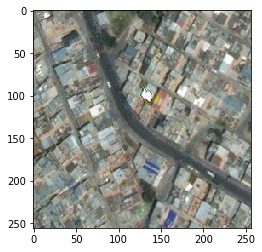

In [24]:
plt.imshow(satellite_test[:,:,:3])

In [27]:
satellite_test[:,:,:3]

array([[[132, 133, 128],
        [121, 122, 117],
        [112, 113, 108],
        ...,
        [102,  98,  87],
        [118, 120, 107],
        [144, 146, 133]],

       [[124, 126, 121],
        [115, 116, 111],
        [101, 103,  98],
        ...,
        [124, 120, 109],
        [142, 142, 130],
        [151, 151, 139]],

       [[128, 130, 125],
        [113, 115, 110],
        [ 96,  98,  93],
        ...,
        [151, 145, 133],
        [160, 156, 144],
        [144, 140, 128]],

       ...,

       [[121, 131, 122],
        [118, 128, 119],
        [114, 122, 111],
        ...,
        [136, 130, 118],
        [ 99,  99,  91],
        [111, 110, 105]],

       [[126, 137, 129],
        [114, 126, 116],
        [ 83,  93,  84],
        ...,
        [111, 105,  93],
        [ 95,  94,  89],
        [137, 136, 131]],

       [[109, 120, 112],
        [107, 118, 110],
        [111, 122, 114],
        ...,
        [106, 100,  88],
        [104, 103,  98],
        [164, 163, 158]]

In [33]:
layers_test = io.imread("./data/dataset/overlap/train/layer_economic/19/13.png")

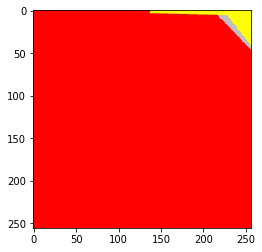

In [34]:
plt.imshow(layers_test[:,:,:3])

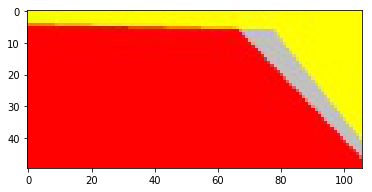

In [42]:
plt.imshow(layers_test[:50,150:,:3])

In [43]:
layers_test[:50,150:,:3]

array([[[255, 245,   9],
        [255, 245,   8],
        [255, 246,   9],
        ...,
        [255, 255,   1],
        [255, 255,   1],
        [255, 255,   1]],

       [[244, 255,   0],
        [245, 255,   0],
        [246, 255,   0],
        ...,
        [255, 255,   1],
        [255, 255,   1],
        [255, 255,   1]],

       [[238, 255,   0],
        [238, 255,   0],
        [238, 255,   0],
        ...,
        [255, 255,   1],
        [255, 255,   1],
        [255, 255,   1]],

       ...,

       [[255,   1,   1],
        [255,   1,   1],
        [255,   1,   1],
        ...,
        [255,   2,   0],
        [243,   9,   8],
        [195,  24,  17]],

       [[255,   1,   1],
        [255,   1,   1],
        [255,   1,   1],
        ...,
        [255,   1,   1],
        [255,   1,   1],
        [255,   1,   1]],

       [[255,   1,   1],
        [255,   1,   1],
        [255,   1,   1],
        ...,
        [255,   1,   1],
        [255,   1,   1],
        [255,   1,   1]]

Como se puede ver no todos los amarillos son los mismo amarillos. aparte de eso hay imagenes satelitales incompletas como las siguientes.

In [47]:
satellite_test = io.imread("./data/dataset/overlap/train/satellite/18/300.png")

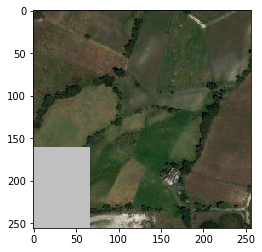

In [48]:
plt.imshow(satellite_test)

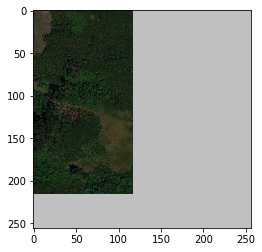

In [50]:
satellite_test = io.imread("./data/dataset/overlap/train/satellite/18/14.png")
plt.imshow(satellite_test)

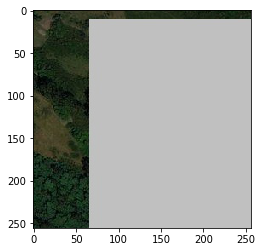

In [51]:
satellite_test = io.imread("./data/dataset/overlap/train/satellite/18/28.png")
plt.imshow(satellite_test)

In [361]:
def subdiv_img(img, ancho, alto):
    pass

306 527


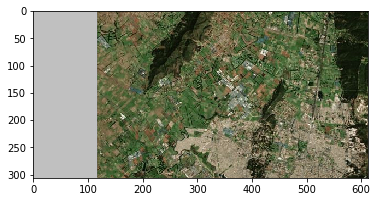

In [88]:
x, y = int_div[1] # cantidad de subimagenes en x y y

Δx = int(img.shape[1]/x) # Cuanto se debe mover en x la "ventana" para cortar las imagenes
Δy = int(img.shape[0]/y) # Cuanto se debe mover en y la "ventana" para cortar las imagenes
print(Δx,Δy)
plt.imshow(img[0:Δx][0:Δy][:]) #imprime una de las sub imagenes de la imagen

In [426]:
init_y = 0 # Variable para controlar el movimiento en y
init_x = 0

for i in range(x):
    for j in range(y):
        print(init_x,(j+1)*Δx)
        print(init_y,(i+1)*Δy)
        img_end = img[init_y:(i+1)*Δy, init_x:(j+1)*Δx][:]
        plt.imsave(fname="./data/bogota/"+str(i)+str(j),arr=img_end, format="png")
        init_x = init_x + (j+1)*Δx
    init_x = 0 
    init_y = init_y + (i+1)*Δy                     # Actualiza el punto inicial   
                          
    

0 306
0 527
306 612
0 527
0 306
527 1054
306 612
527 1054


In [21]:
def subdiv_img(zoom,tipo,cantidad,int_div):
    
    x, y = int_div[zoom-12] # cantidad de subimagenes en x y y
    fname = "./data/bogota/"+tipo+"/"+str(zoom)+"/"
    cont = 0
    init_y = 0 # Variable para controlar el movimiento en y
    init_x = 0
    img = io.imread(fname+tipo+"_"+str(zoom)+"_"+str(cantidad)+".jpg") 
    
    Δx = int(img.shape[1]/x) # Cuanto se debe mover en x la "ventana" para cortar las imagenes
    Δy = int(img.shape[0]/y) # Cuanto se debe mover en y la "ventana" para cortar las imagenes
    
    
    for i in range(y):
        for j in range(x):            
            
            img_end = img[init_y:(i+1)*Δy, init_x:(j+1)*Δx]
            
            plt.imsave(fname=fname+str((100000000*cantidad)+cont)+".png",arr=img_end, format="png")
            cont = cont + 1
            init_x = init_x + Δx
        init_x = 0 
        init_y = init_y + Δy  

In [23]:
zoom = 13
tipo = "satelital"

for i in contenido['satelital_count'][1:]:
    for j in range(i):
        subdiv_img(zoom,tipo,j+1,int_div)    
    zoom = zoom + 1

13
14
15
16
16
16
16
17
17
17
17
17
17
17
17
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


In [46]:
total = [i[0]*i[1] for i in int_div]

In [47]:
np.array(total),"\n",np.array(contenido['satelital_count'])[:-4]
T = np.array(total)*np.array(contenido['satelital_count'])[:-4]


Deben haber un total de imagenes por cada zoom de la sigueinte manera

In [53]:
nuev_dim = ["307 × 528", "306 × 527", "408 × 527","490 × 527","612 × 527", "653 × 511", "653 × 562", "373 × 419 ","548 × 511" ]
for i,j in enumerate(T):
    print("zoom: ", 12+i,"imagenes: ",j,nuev_dim[i])

zoom:  12 imagenes:  0 307 × 528
zoom:  13 imagenes:  4 306 × 527
zoom:  14 imagenes:  12 408 × 527
zoom:  15 imagenes:  40 490 × 527
zoom:  16 imagenes:  128 612 × 527
zoom:  17 imagenes:  495 653 × 511
zoom:  18 imagenes:  1800 653 × 562
zoom:  19 imagenes:  16905 373 × 419 
zoom:  20 imagenes:  37752 548 × 511


In [52]:
for i in range(121):
    print(chr(96+i))

`
a
b
c
d
e
f
g
h
i
j
k
l
m
n
o
p
q
r
s
t
u
v
w
x
y
z
{
|
}
~

































 
¡
¢
£
¤
¥
¦
§
¨
©
ª
«
¬
­
®
¯
°
±
²
³
´
µ
¶
·
¸
¹
º
»
¼
½
¾
¿
À
Á
Â
Ã
Ä
Å
Æ
Ç
È
É
Ê
Ë
Ì
Í
Î
Ï
Ð
Ñ
Ò
Ó
Ô
Õ
Ö
×
Ø


In [ ]:
hacer segmentacion - Deep nets for eo - segnet - segnet tensorflow